In [3]:
import os
import datetime

from keras.preprocessing import image
import numpy as np
from skimage import io

imgVGGs = []
img3Ds = []

start = datetime.datetime.now()
for imgFP in os.listdir("image1904900000"):
    if imgFP.endswith('jpg'):
        img = image.load_img("image1904900000/" + imgFP, target_size=(224, 224))
#        img = image.load_img("images/" + imgFP)
        img3D = image.img_to_array(img)        
        img3Ds.append(img3D)
        img4D = np.expand_dims(img3D, axis=0)        
        imgVGGs = np.concatenate((imgVGGs, img4D)) if 0 < len(imgVGGs) else img4D
end = datetime.datetime.now()
print((end-start).seconds)

69


In [3]:
from keras.applications.vgg16 import preprocess_input
imgVGGs = preprocess_input(imgVGGs)
imgVGGs.shape

(556, 224, 224, 3)

In [4]:
from keras.applications.vgg16 import VGG16
model = VGG16(weights='imagenet', include_top=False)

In [5]:
imgFeas = model.predict(imgVGGs)
imgFea1Ds = imgFeas.reshape(imgVGGs.shape[0], 7*7*512)

In [6]:
imgFea1Ds.shape

(556, 25088)

In [7]:
def cosine_similarity(ratings):
    sim = ratings.dot(ratings.T)
    if not isinstance(sim, np.ndarray):
        sim = sim.toarray()
    norms = np.array([np.sqrt(np.diagonal(sim))])
    return (sim / norms / norms.T)

sim = cosine_similarity(imgFea1Ds)
sim.shape

(556, 556)

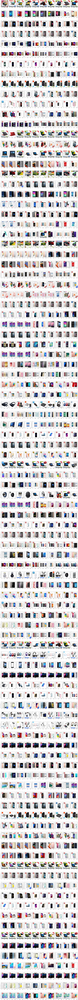

In [8]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(30,400))
#fig = plt.figure(figsize=(30,40))

cnt = 1
#for i in range(0, len(sim)):
for i in range(0, 100):
    for sim_i in np.argsort(sim[i])[0:10]:
        plt.subplot(100, 10, cnt)
        plt.imshow(img3Ds[sim_i].astype('uint8'))
        cnt += 1
plt.show()